In [22]:
import folium
from folium import plugins
from folium.plugins import HeatMap
import pandas as pd
import numpy as np
import soundfile as sf
import scipy.signal as signal
import matplotlib.pyplot as plt
import os

In [20]:
map_hooray = folium.Map(location=[51.5074, 0.1278],
                    zoom_start = 11) # Uses lat then lon. The bigger the zoom number, the closer in you get

In [54]:
metadata = pd.read_csv("/Users/Jake/Desktop/british-birdsong-dataset/birdsong_metadata.csv")
metadata.columns = ['file_id',
 'genus',
 'species',
 'english_cname',
 'who_provided_recording',
 'country',
 'latitude',
 'longitude',
 'type',
 'license']

metadata['latitude'] =  metadata['latitude'].astype(float)
metadata['longitude'] = metadata['longitude'].astype(float)

coords = metadata[['latitude', 'longitude']]
coords = metadata.dropna(axis=0, subset=['latitude','longitude'])

# List comprehension to make out list of lists
geos = [[row['latitude'],row['longitude']] for index, row in coords.iterrows()]

# Plot it on the map
HeatMap(geos).add_to(map_hooray)

# Display the map
map_hooray

In [71]:
metadata.describe(include='all')

,file_id,genus,species,english_cname,who_provided_recording,country,latitude,longitude,type,license
count,264.000000,264,264,264,264,264,261.000000,261.000000,264,264
unique,NaN,66,85,88,68,18,NaN,NaN,54,4
top,NaN,Sylvia,montanus,Eurasian Golden Oriole,Richard Dunn,United Kingdom,NaN,NaN,song,http://creativecommons.org/licenses/by-nc-nd/2.5/
freq,NaN,12,6,3,35,120,NaN,NaN,108,127
mean,98782.503788,NaN,NaN,NaN,NaN,NaN,53.007356,5.676923,NaN,NaN
std,38058.627589,NaN,NaN,NaN,NaN,NaN,9.352445,9.482390,NaN,NaN
min,25119.000000,NaN,NaN,NaN,NaN,NaN,-17.807000,-21.622100,NaN,NaN
25%,71674.500000,NaN,NaN,NaN,NaN,NaN,51.257300,-1.505000,NaN,NaN
50%,101619.500000,NaN,NaN,NaN,NaN,NaN,53.095600,1.108900,NaN,NaN
75%,130727.500000,NaN,NaN,NaN,NaN,NaN,55.628900,14.084300,NaN,NaN


In [99]:
metadata.dtypes

file_id                     int64
genus                      object
species                    object
english_cname              object
who_provided_recording     object
country                    object
latitude                  float64
longitude                 float64
type                       object
license                    object
dtype: object

In [100]:
spec_dict = dict(zip(metadata.file_id, metadata.species))
spec_dict[int("132608")]

'flammea'

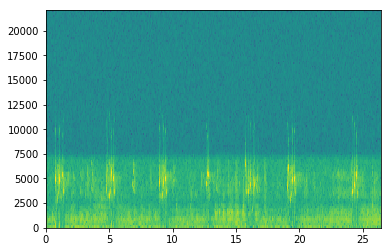

In [40]:
#aguimp calls
data1, samplerate1 = sf.read("/Users/Jake/Desktop/british-birdsong-dataset/songs/xc41428.flac")
data2, samplerate2 = sf.read("/Users/Jake/Desktop/british-birdsong-dataset/songs/xc118441.flac")
data3, samplerate3 = sf.read("/Users/Jake/Desktop/british-birdsong-dataset/songs/xc125137.flac")

#plt.ylabel('Frequency [Hz]')
#plt.xlabel('Time [sec]')
Pxx, freqs, bins, im = plt.specgram(data, Fs=samplerate)

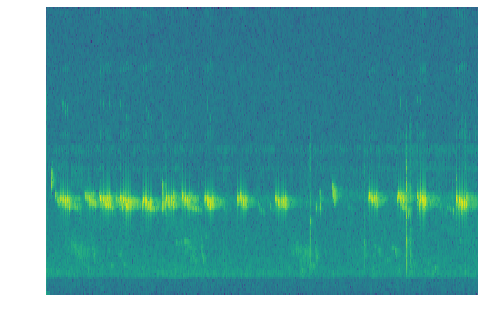

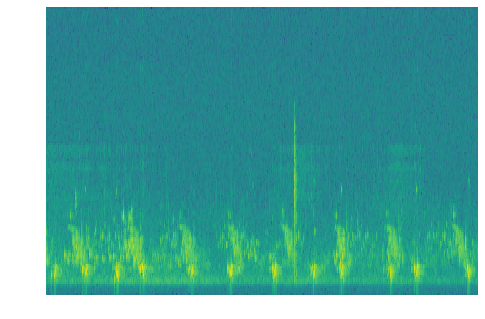

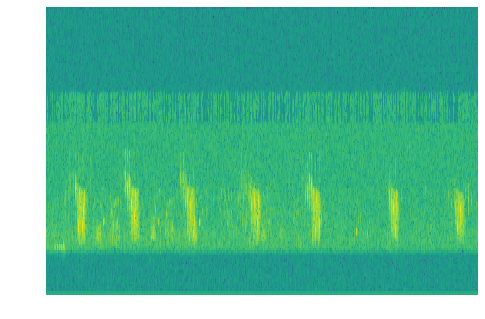

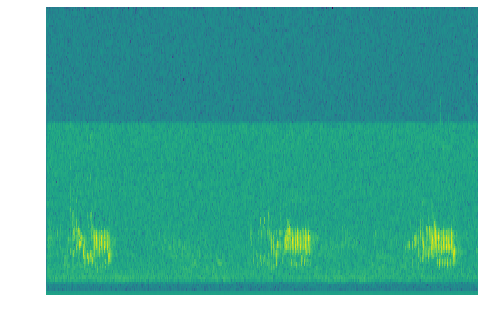

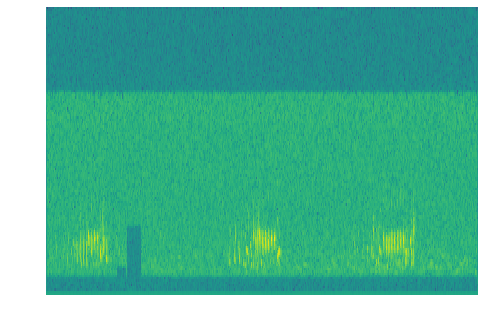

...

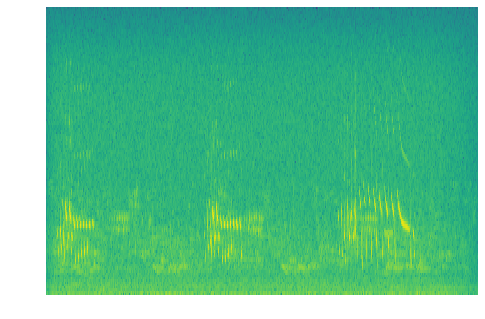

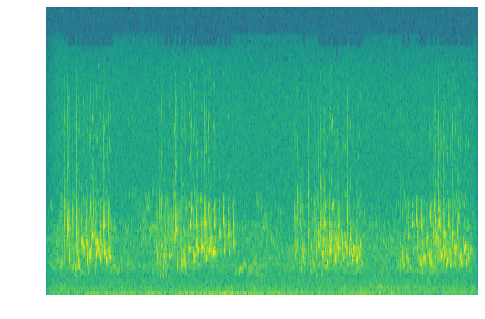

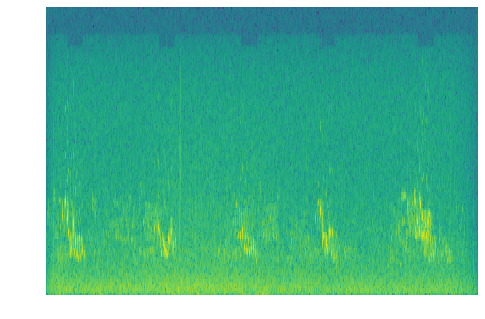

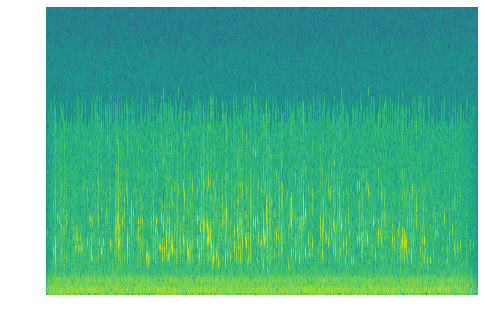

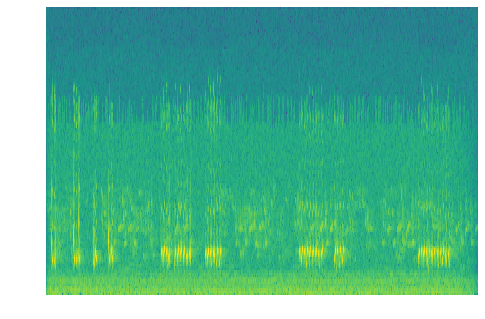

In [105]:
def sound_to_img(filename, sdict):
    path_song = "/Users/Jake/Desktop/british-birdsong-dataset/songs/"
    path_imgs = "/Users/Jake/Desktop/british-birdsong-dataset/imgs/"
    song_id  = filename.split('.')[0]
    ids = song_id.split("c",1)[1]
    specie = sdict[int(ids)]
    
    data, samplerate = sf.read(path_song+filename)
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('off')
    pxx, freqs, bins, im = ax.specgram(x=data, Fs=samplerate)
    ax.axis('off')
    if not os.path.exists(path_imgs+specie):
        os.makedirs(path_imgs+specie)
    
    fig.savefig(path_imgs+specie+"/"+song_id+'_'+specie+'.png', dpi=300, frameon='false')

directory = os.fsencode("/Users/Jake/Desktop/british-birdsong-dataset/songs/")

for file in os.listdir(directory):
     filename = os.fsdecode(file)
     if filename.endswith(".flac"): 
         sound_to_img(filename,spec_dict)
     else:
         continue
            
            